<a href="https://colab.research.google.com/github/kyle-gao/GRSS_TrackMSD2021/blob/main/CoregistrationNAIP_LANDSAT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Coregistration of NAIP and NLCD

https://nrcs.app.box.com/v/naip

In [1]:
import gdal
import numpy as np
import matplotlib.pyplot as plt
import PIL
import os

In [2]:
!wget https://eoimages.gsfc.nasa.gov/images/imagerecords/3000/3678/nyc_ast_08sep02_crop_geo.tif

--2021-01-27 00:36:49--  https://eoimages.gsfc.nasa.gov/images/imagerecords/3000/3678/nyc_ast_08sep02_crop_geo.tif
Resolving eoimages.gsfc.nasa.gov (eoimages.gsfc.nasa.gov)... 129.164.142.12, 2001:4d0:2310:170::12
Connecting to eoimages.gsfc.nasa.gov (eoimages.gsfc.nasa.gov)|129.164.142.12|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 42004595 (40M) [image/tiff]
Saving to: ‘nyc_ast_08sep02_crop_geo.tif.2’

nyc_ast_08sep02_cro 100%[===================>]  40.06M  58.8MB/s    in 0.7s    

2021-01-27 00:36:50 (58.8 MB/s) - ‘nyc_ast_08sep02_crop_geo.tif.2’ saved [42004595/42004595]



In [3]:
landsatny = gdal.Open("/content/nyc_ast_08sep02_crop_geo.tif")
landsatny_img = landsatny.ReadAsArray().transpose([1,2,0])

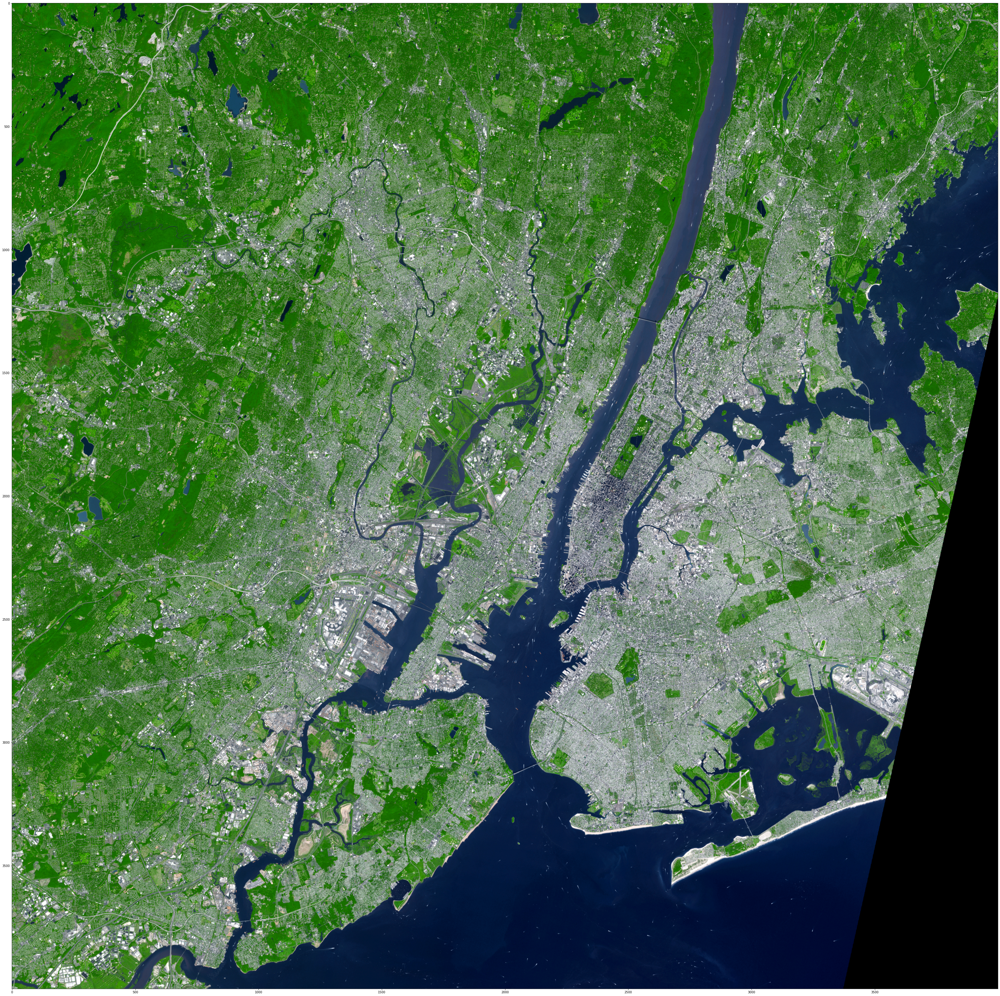

In [4]:
plt.figure(figsize=(60,60))
plt.imshow(landsatny_img[:,:,0:3])

In [5]:
landsatny.GetGeoTransform()

(549582.1836657122, 15.0, 0.0, 4542175.970671966, 0.0, -15.0)

Xgeo = GT(0) + Xpixel*GT(1) + Yline*GT(2)

Ygeo = GT(3) + Xpixel*GT(4) + Yline*GT(5)


In case of north up images, the GT(2) and GT(4) coefficients are zero, and the GT(1) is pixel width, and GT(5) is pixel height. The (GT(0),GT(3)) position is the top left corner of the top left pixel of the raster.

In [6]:
!wget https://coast.noaa.gov/htdata/raster2/imagery/NY_NAIP_2017_9125/m_4007326_nw_18_1_20170809.tif

--2021-01-27 00:37:03--  https://coast.noaa.gov/htdata/raster2/imagery/NY_NAIP_2017_9125/m_4007326_nw_18_1_20170809.tif
Resolving coast.noaa.gov (coast.noaa.gov)... 40.70.244.79
Connecting to coast.noaa.gov (coast.noaa.gov)|40.70.244.79|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 182075199 (174M) [image/tiff]
Saving to: ‘m_4007326_nw_18_1_20170809.tif.1’

m_4007326_nw_18_1_2 100%[===================>] 173.64M  21.8MB/s    in 9.0s    

2021-01-27 00:37:12 (19.4 MB/s) - ‘m_4007326_nw_18_1_20170809.tif.1’ saved [182075199/182075199]



In [7]:
naiptile = gdal.Open("/content/m_4007326_nw_18_1_20170809.tif")
naiptile.GetGeoTransform()

(594849.0, 1.0, 0.0, 4498108.0, 0.0, -1.0)

In [8]:
naipimg = naiptile.ReadAsArray().transpose([1,2,0])

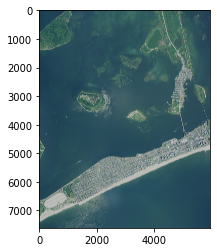

In [9]:
plt.imshow(naipimg[:,:,0:3])

In [10]:
naipGT = naiptile.GetGeoTransform()
lsGT = landsatny.GetGeoTransform()

In [11]:
def get_box (arr_shape, GeoTransform):
  """Args
  arr_shape:tuple, (band, width, length)
  GeoTransform: tuple, from Gdal.GetGeoTransform()
  returns georeferenced coordinates of box corners (left, up , right, down) """
  length,width = arr_shape[1],arr_shape[2]
  x0, y0 = (GeoTransform[0],GeoTransform[3])
  x1 = x0 + width*GeoTransform[1]
  y1 = y0 + length*GeoTransform[5]
  return (x0, y0, x1, y1)
  

In [12]:
naipbox = get_box(naiptile.ReadAsArray().shape,naiptile.GetGeoTransform())

In [13]:
def match_box(smallbox, LargeGT):
  """
  Args:
  smallbox:tuple-the georeferenced coordinates of the high resolution image's box
  LargeGT: the Gdal.GeoTransform() of the low resolution image
  Returns:
  smallbox in the coordinates of LargeGT

  """
  x0 = (smallbox[0]-LargeGT[0])/LargeGT[1]
  x1 = (smallbox[2]-LargeGT[0])/LargeGT[1]
  y0 = (smallbox[1]-LargeGT[3])/LargeGT[5]
  y1 = (smallbox[3]-LargeGT[3])/LargeGT[5]
  box = (x0,y0,x1,y1)
  return box

In [14]:
newidx = match_box(naipbox,lsGT)
print(newidx)

(3017.7877556191834, 2937.8647114643827, 3416.521088952517, 3445.0647114643825)


In [15]:
def resize_img(img_arr, shape, box, interpolation = PIL.Image.LINEAR):
  """
  img_arr: np.array
  shape: tuple (width,height)
  interpolation: see PIL.Image.resize(resample = ...)
  box:tuple (left, up, right , down)
  """
  image = PIL.Image.fromarray(img_arr)
  newimg = image.resize(shape, resample = interpolation, box = box)
  return newimg

In [16]:
#PIL reads width,height, opposite of numpy
shape = (naipimg.shape[1],naipimg.shape[0])
print(shape)

(5981, 7608)


In [17]:
newimage = resize_img(landsatny_img[:,:,0:3], shape = shape, box=newidx)
newimage_arr = np.array(newimage)

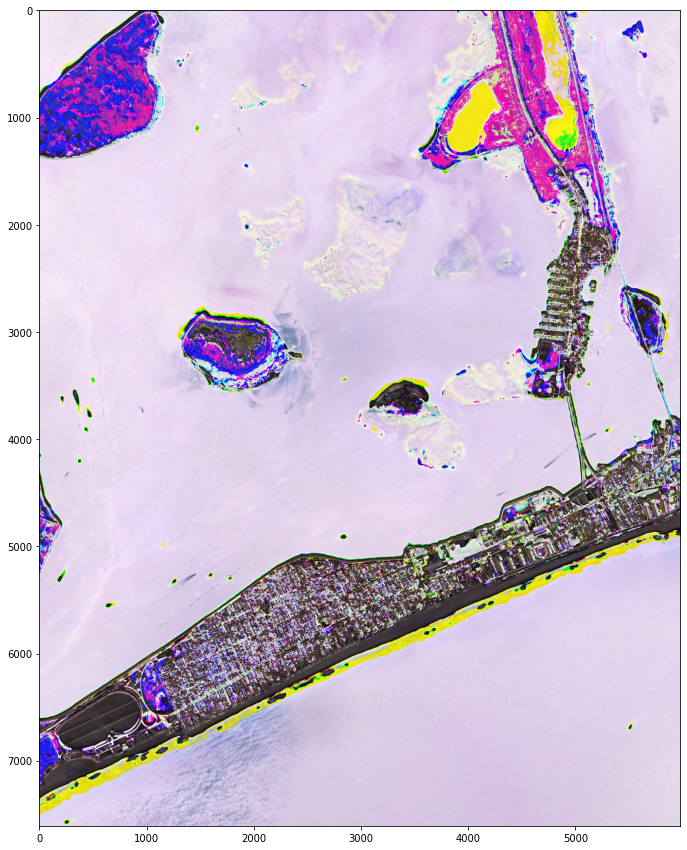

In [18]:
plt.figure(figsize = (60/5,75/5))
plt.imshow(newimage_arr-naipimg[:,:,0:3])

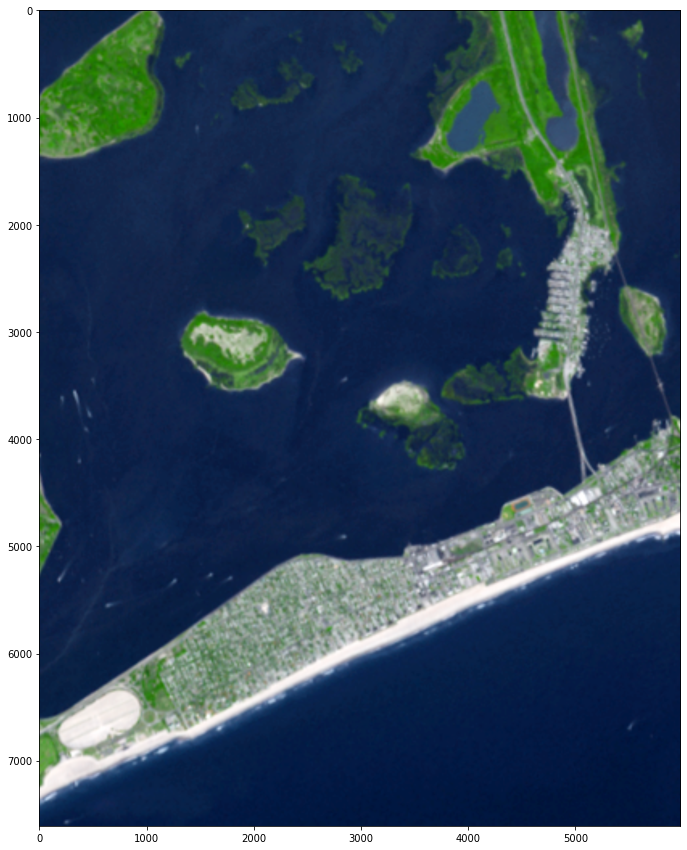

In [21]:
plt.figure(figsize = (30,15))
plt.imshow(newimage_arr)

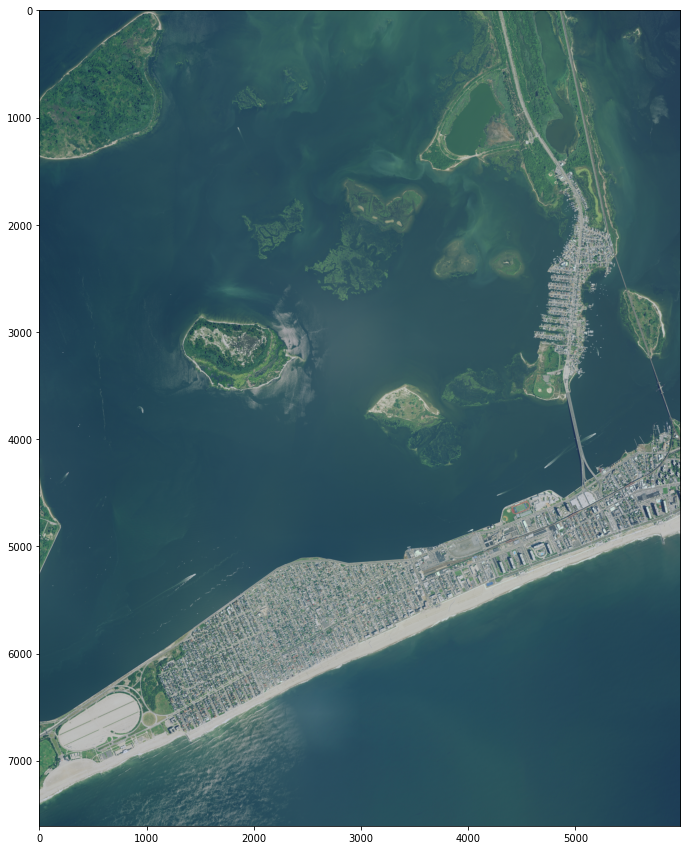

In [20]:
plt.figure(figsize = (30,15))
plt.imshow(naipimg[:,:,0:3])